In [17]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Two Dimensional models

## Models

1. Diffusion
2. Convection
3. Convection Diffusion

All models calculated using the finite-difference method in 2 dimensions. 


The models can be visualised using two types of animations.

1. Color animated plots
2. 3D animated plots

These partial differential equations are solved for a function $u(x, t)$ in discretized time $t$ and space $x$. See source code `diffuconpy` to see the full implementation of the finite difference method. 

In [18]:
import numpy as np
import matplotlib.pyplot as plt
plt.style.use("dark_background")
import sys, os

sys.path.append(os.path.abspath(os.path.join('..')))

import diffuconpy as dc
import animations


In [19]:
class ExamplePlot:
    
    def __init__(self, model, dx, title, limx, limy, fps, frn, filename):
        self.model = model
        self.title = title
        self.limx = limx
        self.limy = limy
        self.fps = fps
        self.frn = frn
        self.filename = filename
        self.dx = dx

        xvar = np.arange(limx[0], limx[1], self.dx)
        yvar = np.arange(limy[0], limy[1], self.dx)

        self.X, self.Y = np.meshgrid(xvar, yvar)

        

    def CreateAnimation_color(self):
        """
        Saves a colour plot animation as a GIF file. 2 dimensional solutions only.
        """
        try:   
            animations.animation_color(solution=self.model.solution, xlab='x', ylab='y', title=self.title, xlim_=self.limx, ylim_=self.limy, fps=self.fps, frn=self.frn, filename=self.filename)
            print('PLOT SAVED SUCCESSFULLY \n--------------------')
        except:
            Exception('ERROR!')

    def CreateAnimation_3D(self):
        """
        Saves a 3D plot animation as a GIF file. 2 dimensional solutions only.
        """
        try:   
            animations.animation_2(solution=self.model.solution, X=self.X, Y=self.Y, xlab='x', ylab='y', zlab='solution', title=self.title, zlim=(-5, 10), fps=self.fps, frn=self.frn, filename=self.filename)
            print('PLOT SAVED SUCCESSFULLY \n--------------------')
        except:
            Exception('ERROR!')


In [20]:
# Initialising the models.
# All models shown here will use all these same parameters
dx = 0.1
dt = 0.1
limx = (-5, 5)
limy = (-5, 5)
fps = 60
frn = 250

xvar = np.arange(limx[0], limx[1], dx)
yvar = np.arange(limy[0], limy[1], dx)

X, Y = np.meshgrid(xvar, yvar)

init = 4*(1/np.sqrt(0.01*2*np.pi))*np.exp(-(1/2)*((X**2 + Y**2)/0.1))

### Diffusion and convection coefficents

see [README](../README.md).

In [21]:
diffusion = 0.009
convection = -0.1

### Boundary Conditions

In the models that have diffusion, boundary conditions are imposed. The boundary of the solution is set to zero everywhere when Dirichlet boundary conditions are imposed. The boundary of the flux or the first derivative of the solution is set to zero everywhere when Neumann boundary conditions are imposed. 

In [22]:
boundary = [0, 0, 0, 0]
flux_boundary = [0, 0, 0, 0]

## Diffusion

### Color plots

In [23]:
Nt1 = 250
Nx1 = 100

TITLE_1_D = 'Diffusion in 2 dimensions with Dirichlet boundary conditions'
FILE_1_D_color = 'img//animation_diffusion_2dims_dirichlet_color.gif'

TITLE_1_N = 'Diffusion in 2 dimensions with Neumann boundary conditions'
FILE_1_N_color = 'img//animation_diffusion_2dims_neumann_color.gif'

model1 = dc.diffusion_2dims(Nt1, Nx1, dt, dx, diffusion, init)

# Dirichlet boundary conditions
sol1_dirichlet = model1.solve_Dirichlet(boundary)

# Neumann boundary conditions 
sol1_neumann = model1.solve_Neumann(flux_boundary)


model1_plot_D = ExamplePlot(sol1_dirichlet, dx, TITLE_1_D, limx, limy, fps, frn, FILE_1_D_color)

model1_plot_N = ExamplePlot(sol1_neumann, dx, TITLE_1_N, limx, limy, fps, frn, FILE_1_N_color)


In [9]:
model1_plot_D.CreateAnimation_color()
model1_plot_N.CreateAnimation_color()

PLOT SAVED SUCCESSFULLY 
--------------------
PLOT SAVED SUCCESSFULLY 
--------------------


### Animations

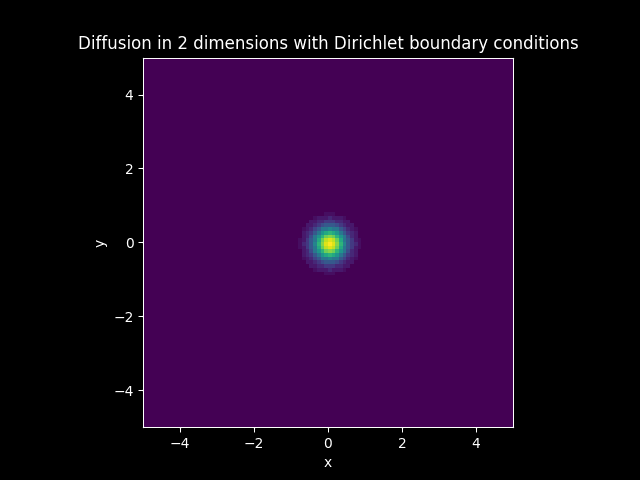

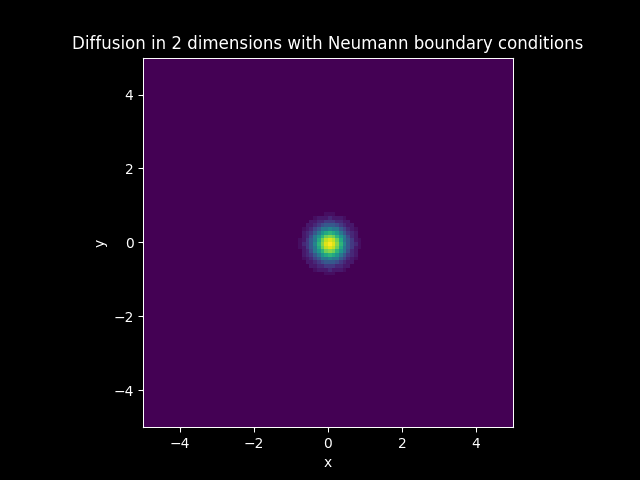

### 3D plots

In [10]:
FILE_1_D_3D = 'img//animation_diffusion_2dims_dirichlet_3D.gif'
FILE_1_N_3D = 'img//animation_diffusion_2dims_neumann_3D.gif'

model1_plot_D = ExamplePlot(sol1_dirichlet, dx, TITLE_1_D, limx, limy, fps, frn, FILE_1_D_3D)
model1_plot_N = ExamplePlot(sol1_neumann, dx, TITLE_1_N, limx, limy, fps, frn, FILE_1_N_3D)

In [11]:
model1_plot_D.CreateAnimation_3D()
model1_plot_N.CreateAnimation_3D()

PLOT SAVED SUCCESSFULLY 
--------------------
PLOT SAVED SUCCESSFULLY 
--------------------


### Animations

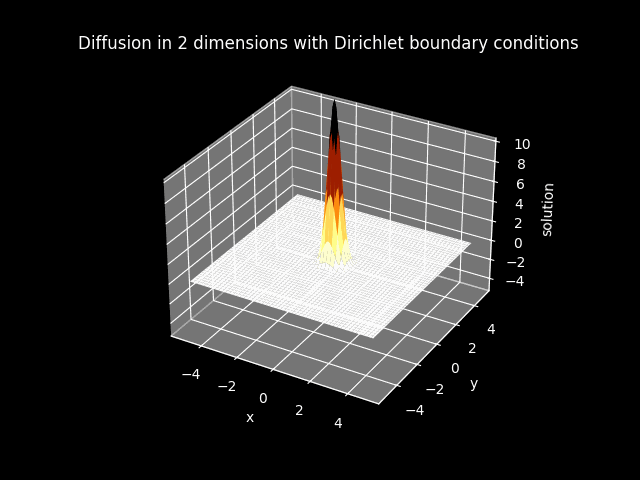

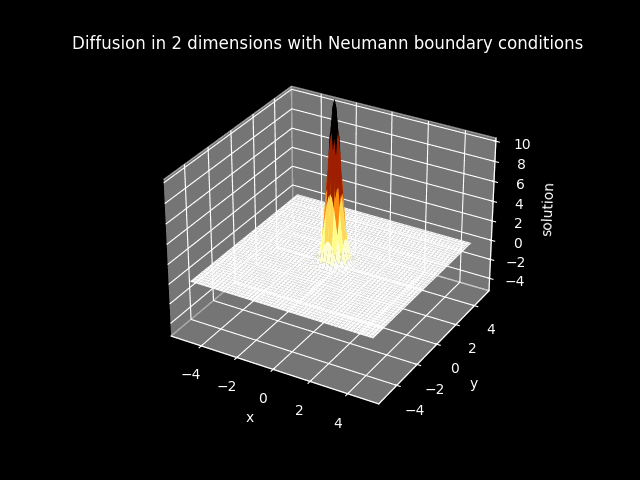

## Convection

### Color plots

In [12]:
Nt2 = 250
Nx2 = 200

TITLE_2 = 'Convection in 2 dimensions'
FILE_2_color = 'img//animation_convection_2dims_color.gif'

model2 = dc.convection_2dims(Nt2, Nx2, dt, dx, convection, init)

sol2 = model2.solve()

model2_plot = ExamplePlot(sol2, dx, TITLE_2, limx, limy, fps, frn, FILE_2_color)

In [13]:
model2_plot.CreateAnimation_color()

PLOT SAVED SUCCESSFULLY 
--------------------


### Animations

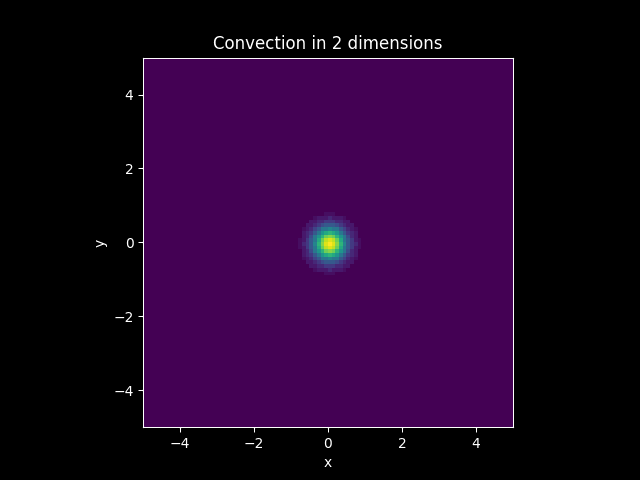

### 3D plots

In [14]:
FILE_2_3D = 'img//animation_convection_2dims_3D.gif'

model2_plot = ExamplePlot(sol2, dx, TITLE_2, limx, limy, fps, frn, FILE_2_3D)

In [15]:
model2_plot.CreateAnimation_3D()

PLOT SAVED SUCCESSFULLY 
--------------------


### Animations

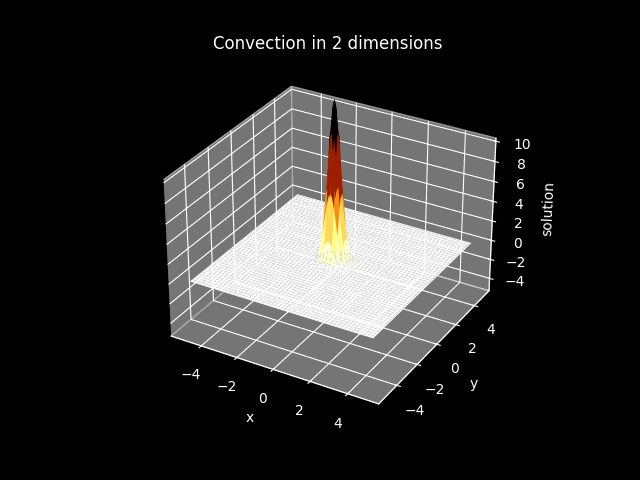

## Convection Diffusion

### Color plots

In [27]:
Nt3 = 250
Nx3 = 200

TITLE_3_D = 'Convection Diffusion in 2 dimensions with Dirichlet boundary conditions'
FILE_3_D_color = 'img//animation_convection_diffusion_2dims_dirichlet_color.gif'

TITLE_3_N = 'Convection Diffusion in 2 dimensions with Neumann boundary conditions'
FILE_3_N_color = 'img//animation_convection_diffusion_2dims_neumann_color.gif'

model3 = dc.convection_diffusion_2dims(Nt3, Nx3, dt, dx, diffusion, convection, init)

# Dirichlet boundary conditions
sol3_dirichlet = model3.solve_Dirichlet(boundary)

# Neumann boundary conditions 
sol3_neumann = model3.solve_Neumann(flux_boundary)


model3_plot_D = ExamplePlot(sol3_dirichlet, dx, TITLE_3_D, limx, limy, fps, frn, FILE_3_D_color)

model3_plot_N = ExamplePlot(sol3_neumann, dx, TITLE_3_N, limx, limy, fps, frn, FILE_3_N_color)

In [28]:
model3_plot_D.CreateAnimation_color()
model3_plot_N.CreateAnimation_color()

PLOT SAVED SUCCESSFULLY 
--------------------
PLOT SAVED SUCCESSFULLY 
--------------------


### Animations

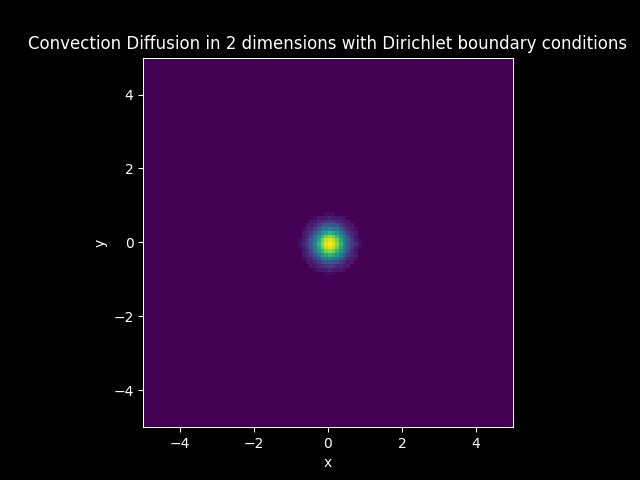

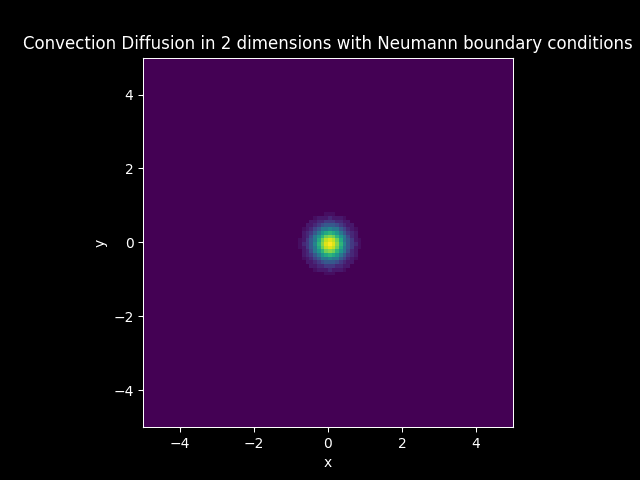

### 3D plots

In [29]:
FILE_3_D_3D = 'img//animation_convection_diffusion_2dims_dirichlet_3D.gif'
FILE_3_N_3D = 'img//animation_convection_diffusion_2dims_neumann_3D.gif'

model3_plot_D = ExamplePlot(sol3_dirichlet, dx, TITLE_3_D, limx, limy, fps, frn, FILE_3_D_3D)
model3_plot_N = ExamplePlot(sol3_neumann, dx, TITLE_3_N, limx, limy, fps, frn, FILE_3_N_3D)

In [30]:
model3_plot_D.CreateAnimation_3D()
model3_plot_N.CreateAnimation_3D()

PLOT SAVED SUCCESSFULLY 
--------------------
PLOT SAVED SUCCESSFULLY 
--------------------


### Animations

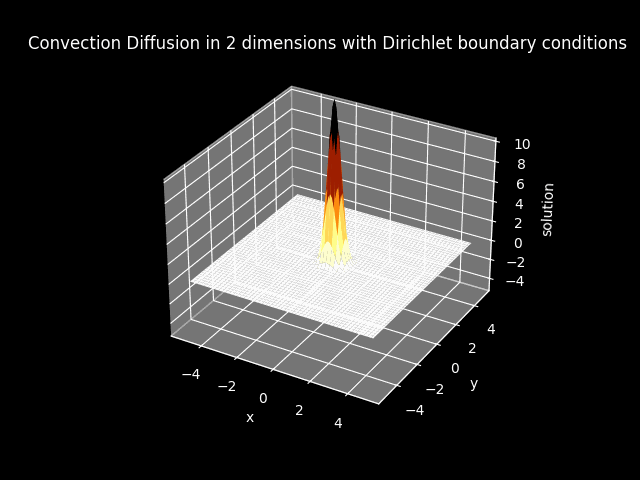

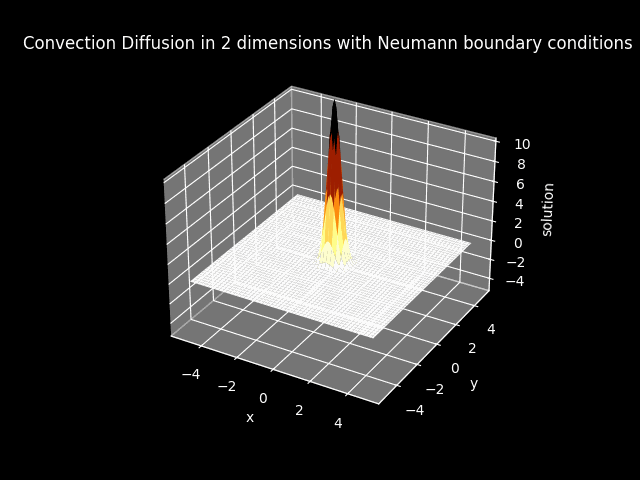

WARNING: The 3D animation are extremely slow to generate, with at most 1 minute run time. 

It is better to generate these solutions as color plot animations, with at most 11 seconds run time.